## Building the basic mathematical building Blocks - Antipodality and XOR-XNOR planes

In the next two section we consider differentaition and hyperbolic transformation in relation to the sphere. These concepts become useful in considering relationship to Machine Learning

### D)  Sphere Rotation - differentiation and summation (integration)

In the previous chapter, the idea of **differential forms** as fractional bivectors was introduced. Further it was proposed that such fracitonal areas (both on the sphere and the complex plane) can be summed to produce a path. Thus, path inmtegration either on the plane or the sphere surface could represent navigation or represent other functions such as dynamic processes (e.g. neuronal membrane dynamics that produce spikes in th potential). This correspondence could be utilized to model any biological processes that involve partial differential equations and integration.Below the code produces an animation. You could run the animation step by step to visuaalise how summation of area could occur. This is only for illustrative purposes. 

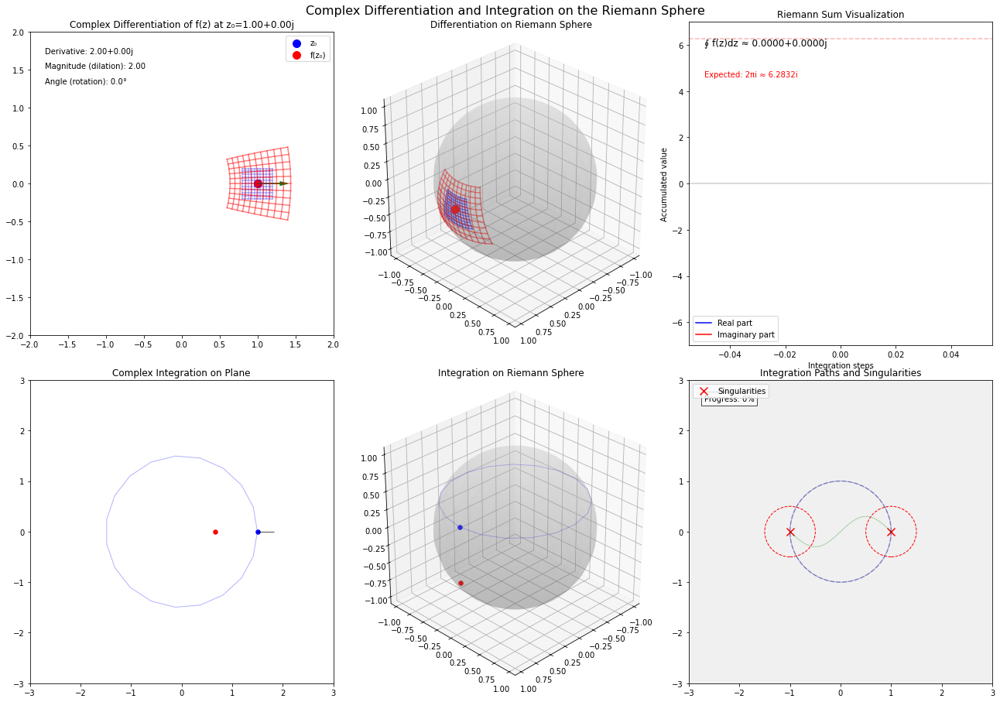

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.colors as mcolors
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from IPython.display import HTML

# Add these at the top of your code (before creating the figure to avoid animation size limit)
plt.rcParams['animation.embed_limit'] = 30  # Increase to 30MB (default is 20MB)
plt.rcParams['figure.dpi'] = 72  # Reduce from default 100 dpi

# Create figure with slightly more height
fig = plt.figure(figsize=(18, 13))

# Create subplots as before
ax_diff_plane = fig.add_subplot(231)
ax_diff_sphere = fig.add_subplot(232, projection='3d')
ax_riemann_sum = fig.add_subplot(233)
ax_int_plane = fig.add_subplot(234)
ax_int_sphere = fig.add_subplot(235, projection='3d')
ax_path = fig.add_subplot(236)

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.4, top=0.9, bottom=0.1)

# Add the main title
plt.suptitle("Complex Differentiation and Integration on the Riemann Sphere", fontsize=16, y=0.98)

# Define animation parameters
total_frames = 60  # Define total frames for the animation

# Define complex functions to visualize
def f1(z):
    """Simple function: f(z) = z^2"""
    return z**2

def f2(z):
    """Function with singularity: f(z) = 1/z"""
    return 1/z

def f3(z):
    """Function with multiple singularities: f(z) = z/(z^2-1)"""
    return z/(z**2-1)

# Function to compute derivative
def derivative(f, z0, h=1e-6):
    """Compute numerical derivative of f at z0"""
    return (f(z0 + h) - f(z0)) / h

# Function to map complex plane to Riemann sphere
def plane_to_sphere(z):
    """Map point from complex plane to Riemann sphere using stereographic projection"""
    x = z.real
    y = z.imag
    denom = 1 + x**2 + y**2
    return np.array([2*x/denom, 2*y/denom, (denom - 2)/denom])

# Function to visualize complex differentiation
def visualize_differentiation(ax_plane, ax_sphere, f, z0, grid_size=11):
    """Visualize how complex differentiation produces rotation and dilation"""
    # Clear previous plots
    ax_plane.clear()
    ax_sphere.clear()
    
    # Set titles
    ax_plane.set_title(f"Complex Differentiation of f(z) at z₀={z0:.2f}")
    ax_sphere.set_title("Differentiation on Riemann Sphere")
    
    # Compute derivative
    f_prime = derivative(f, z0)
    magnitude = abs(f_prime)
    angle = np.angle(f_prime)
    
    # Create grid around z0
    delta = 0.2
    x = np.linspace(z0.real - delta, z0.real + delta, grid_size)
    y = np.linspace(z0.imag - delta, z0.imag + delta, grid_size)
    X, Y = np.meshgrid(x, y)
    Z = X + 1j*Y
    
    # Compute function values
    W = f(Z)
    
    # Plot original grid on complex plane
    ax_plane.plot(X, Y, 'b-', alpha=0.3)
    ax_plane.plot(X.T, Y.T, 'b-', alpha=0.3)
    
    # Plot transformed grid on complex plane
    ax_plane.plot(W.real, W.imag, 'r-', alpha=0.5)
    ax_plane.plot(W.real.T, W.imag.T, 'r-', alpha=0.5)
    
    # Mark z0 and f(z0)
    ax_plane.scatter(z0.real, z0.imag, color='blue', s=100, label='z₀')
    ax_plane.scatter(f(z0).real, f(z0).imag, color='red', s=100, label='f(z₀)')
    
    # Draw arrow to show derivative
    arrow_length = 0.3
    dx = arrow_length * np.cos(angle)
    dy = arrow_length * np.sin(angle)
    ax_plane.arrow(z0.real, z0.imag, dx, dy, head_width=0.05, head_length=0.1, fc='green', ec='green')
    
    # Add text explaining rotation and dilation
    ax_plane.text(0.05, 0.95, f"Derivative: {f_prime:.2f}", transform=ax_plane.transAxes, 
                 fontsize=10, verticalalignment='top')
    ax_plane.text(0.05, 0.9, f"Magnitude (dilation): {magnitude:.2f}", transform=ax_plane.transAxes, 
                 fontsize=10, verticalalignment='top')
    ax_plane.text(0.05, 0.85, f"Angle (rotation): {angle*180/np.pi:.1f}°", transform=ax_plane.transAxes, 
                 fontsize=10, verticalalignment='top')
    
    # Set equal aspect ratio and limits
    ax_plane.set_aspect('equal')
    ax_plane.set_xlim(-2, 2)
    ax_plane.set_ylim(-2, 2)
    ax_plane.legend()
    
    # Plot on Riemann sphere
    # Create sphere
    u = np.linspace(0, 2 * np.pi, 30)
    v = np.linspace(0, np.pi, 30)
    x_sphere = np.outer(np.cos(u), np.sin(v))
    y_sphere = np.outer(np.sin(u), np.sin(v))
    z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))
    ax_sphere.plot_surface(x_sphere, y_sphere, z_sphere, color='lightgray', alpha=0.2)
    
    # Project grid points to sphere
    for i in range(grid_size):
        points = [plane_to_sphere(Z[i, j]) for j in range(grid_size)]
        xs, ys, zs = zip(*points)
        ax_sphere.plot(xs, ys, zs, 'b-', alpha=0.5)
        
        points = [plane_to_sphere(Z[j, i]) for j in range(grid_size)]
        xs, ys, zs = zip(*points)
        ax_sphere.plot(xs, ys, zs, 'b-', alpha=0.5)
    
    # Project transformed grid to sphere
    for i in range(grid_size):
        points = [plane_to_sphere(W[i, j]) for j in range(grid_size)]
        xs, ys, zs = zip(*points)
        ax_sphere.plot(xs, ys, zs, 'r-', alpha=0.5)
        
        points = [plane_to_sphere(W[j, i]) for j in range(grid_size)]
        xs, ys, zs = zip(*points)
        ax_sphere.plot(xs, ys, zs, 'r-', alpha=0.5)
    
    # Mark z0 and f(z0) on sphere
    z0_sphere = plane_to_sphere(z0)
    fz0_sphere = plane_to_sphere(f(z0))
    ax_sphere.scatter([z0_sphere[0]], [z0_sphere[1]], [z0_sphere[2]], color='blue', s=100)
    ax_sphere.scatter([fz0_sphere[0]], [fz0_sphere[1]], [fz0_sphere[2]], color='red', s=100)
    
    # Set view angle and limits
    ax_sphere.view_init(elev=30, azim=45)
    ax_sphere.set_xlim(-1.1, 1.1)
    ax_sphere.set_ylim(-1.1, 1.1)
    ax_sphere.set_zlim(-1.1, 1.1)
    ax_sphere.set_box_aspect([1, 1, 1])

# Function to visualize complex integration
def visualize_integration(ax_plane, ax_sphere, ax_riemann, f, path_func, t_range, num_points=20):
    """Visualize complex integration as summing infinitesimal areas"""
    # Clear previous plots
    ax_plane.clear()
    ax_sphere.clear()
    ax_riemann.clear()
    
    # Set titles
    ax_plane.set_title("Complex Integration on Plane")
    ax_sphere.set_title("Integration on Riemann Sphere")
    ax_riemann.set_title("Riemann Sum Visualization")
    
    # Generate full path points
    t_full = np.linspace(0, 2*np.pi, num_points)
    full_path = np.array([path_func(ti) for ti in t_full])
    
    # Generate path points up to current progress
    t_end = t_range[1]
    num_current_points = max(2, int(num_points * t_end/(2*np.pi)) + 1)
    t = np.linspace(0, t_end, num_current_points)
    path_points = np.array([path_func(ti) for ti in t])
    
    # Compute function values along path
    f_values = np.array([f(z) for z in path_points])
    
    # Plot full path on complex plane (faded)
    ax_plane.plot(full_path.real, full_path.imag, 'b-', linewidth=1, alpha=0.3)
    
    # Plot current path on complex plane
    ax_plane.plot(path_points.real, path_points.imag, 'b-', linewidth=2)
    if len(path_points) > 0:
        ax_plane.scatter(path_points[-1].real, path_points[-1].imag, color='blue', s=30)
    
    # Plot function values on complex plane
    ax_plane.plot(f_values.real, f_values.imag, 'r-', linewidth=2)
    if len(f_values) > 0:
        ax_plane.scatter(f_values[-1].real, f_values[-1].imag, color='red', s=30)
    
    # Create infinitesimal parallelograms for integration - ENHANCED VISIBILITY
    riemann_sums = []
    riemann_sum = 0
    
    if len(path_points) > 1:  # Only if we have at least 2 points
        for i in range(len(path_points)-1):
            # Path segment
            dz = path_points[i+1] - path_points[i]
            
            # Function value at midpoint
            z_mid = (path_points[i] + path_points[i+1]) / 2
            f_mid = f(z_mid)
            
            # Scale factor for better visibility
            scale = 0.5  # Increased from 0.3
            
            # Create parallelogram vertices
            vertices = np.array([
                [path_points[i].real, path_points[i].imag],
                [path_points[i+1].real, path_points[i+1].imag],
                [path_points[i+1].real + f_mid.real*scale, path_points[i+1].imag + f_mid.imag*scale],
                [path_points[i].real + f_mid.real*scale, path_points[i].imag + f_mid.imag*scale]
            ])
            
            # Draw the parallelogram directly
            color = plt.cm.viridis(i / max(1, len(path_points)-2))
            poly = Polygon(vertices, closed=True, alpha=0.7, facecolor=color, edgecolor='black', linewidth=1)
            ax_plane.add_patch(poly)
            
            # Compute Riemann sum for this segment
            segment_sum = f_mid * dz
            riemann_sum += segment_sum
            riemann_sums.append(riemann_sum)
    
    # Set equal aspect ratio and limits
    ax_plane.set_aspect('equal')
    ax_plane.set_xlim(-3, 3)
    ax_plane.set_ylim(-3, 3)
    
    # Plot on Riemann sphere
    # Create sphere
    u = np.linspace(0, 2 * np.pi, 30)
    v = np.linspace(0, np.pi, 30)
    x_sphere = np.outer(np.cos(u), np.sin(v))
    y_sphere = np.outer(np.sin(u), np.sin(v))
    z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))
    ax_sphere.plot_surface(x_sphere, y_sphere, z_sphere, color='lightgray', alpha=0.2)
    
    # Project full path to sphere (faded)
    full_path_sphere = np.array([plane_to_sphere(z) for z in full_path])
    ax_sphere.plot(full_path_sphere[:, 0], full_path_sphere[:, 1], full_path_sphere[:, 2], 
                  'b-', linewidth=1, alpha=0.3)
    
    # Project current path to sphere
    if len(path_points) > 0:  # Only if we have points
        path_sphere = np.array([plane_to_sphere(z) for z in path_points])
        ax_sphere.plot(path_sphere[:, 0], path_sphere[:, 1], path_sphere[:, 2], 'b-', linewidth=2)
        ax_sphere.scatter([path_sphere[-1, 0]], [path_sphere[-1, 1]], [path_sphere[-1, 2]], 
                         color='blue', s=30)
    
    # Project function values to sphere
    if len(f_values) > 0:  # Only if we have points
        f_sphere = np.array([plane_to_sphere(f_val) for f_val in f_values])
        ax_sphere.plot(f_sphere[:, 0], f_sphere[:, 1], f_sphere[:, 2], 'r-', linewidth=2)
        ax_sphere.scatter([f_sphere[-1, 0]], [f_sphere[-1, 1]], [f_sphere[-1, 2]], 
                         color='red', s=30)
    
    # Set view angle and limits
    ax_sphere.view_init(elev=30, azim=45)
    ax_sphere.set_xlim(-1.1, 1.1)
    ax_sphere.set_ylim(-1.1, 1.1)
    ax_sphere.set_zlim(-1.1, 1.1)
    ax_sphere.set_box_aspect([1, 1, 1])
    
    # Plot Riemann sum accumulation with IMPROVED VISUALIZATION
    if riemann_sums:  # Only if we have sums
        riemann_real = [complex(rs).real for rs in riemann_sums]
        riemann_imag = [complex(rs).imag for rs in riemann_sums]
        
        # Set fixed y-axis limits based on expected final value (2πi)
        ax_riemann.set_ylim(-7, 7)  # Range that comfortably fits 2πi ≈ 6.28i
        
        # Plot with fixed axes
        ax_riemann.plot(range(len(riemann_sums)), riemann_real, 'b-', label='Real part')
        ax_riemann.plot(range(len(riemann_sums)), riemann_imag, 'r-', label='Imaginary part')
        
        # Add reference line at y=0
        ax_riemann.axhline(y=0, color='k', linestyle='-', alpha=0.2)
        
        # Add reference line at y=2π
        ax_riemann.axhline(y=2*np.pi, color='r', linestyle='--', alpha=0.3)
        
        # Set labels and legend
        ax_riemann.set_xlabel('Integration steps')
        ax_riemann.set_ylabel('Accumulated value')
        ax_riemann.legend()
        
        # Display final integral value
        ax_riemann.text(0.05, 0.95, f"∮ f(z)dz ≈ {riemann_sum:.4f}", transform=ax_riemann.transAxes, 
                       fontsize=12, verticalalignment='top')
        
        # Add expected value
        ax_riemann.text(0.05, 0.85, f"Expected: 2πi ≈ {2*np.pi:.4f}i", transform=ax_riemann.transAxes, 
                       fontsize=10, verticalalignment='top', color='red')

# Function to visualize integration paths and singularities
def visualize_paths_and_singularities(ax, f, singularities, progress=1.0):
    """Visualize integration paths and singularities with fixed frame size"""
    # Clear previous plot but maintain limits
    ax.clear()
    
    # Force fixed frame size immediately
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    
    # Set title
    ax.set_title("Integration Paths and Singularities")
    
    # Plot singularities
    ax.scatter([s.real for s in singularities], [s.imag for s in singularities], 
              color='red', s=100, marker='x', label='Singularities')
    
    # Draw circles around singularities
    for s in singularities:
        circle = plt.Circle((s.real, s.imag), 0.5, fill=False, color='red', linestyle='--')
        ax.add_artist(circle)
    
    # SIMPLIFIED BACKGROUND - just use a light color instead of domain coloring
    # This reduces complexity and potential sizing issues
    ax.set_facecolor('#f0f0f0')  # Light gray background
    
    # Draw a unit circle for reference
    theta = np.linspace(0, 2*np.pi, 100)
    unit_circle = np.exp(1j * theta)
    ax.plot(unit_circle.real, unit_circle.imag, 'k--', alpha=0.3)
    
    # STATIC PATHS - Draw complete paths first
    # Path 1: Circle around origin
    circle_path_full = 1.0 * np.exp(1j * theta)
    ax.plot(circle_path_full.real, circle_path_full.imag, 'b-', linewidth=1, alpha=0.3)
    
    # Path 2: Between singularities
    if len(singularities) >= 2:
        t_full = np.linspace(0, 1, 100)
        path_full = singularities[0] + t_full * (singularities[1] - singularities[0])
        path_full = path_full + 0.3j * np.sin(2*np.pi*t_full)
        ax.plot(path_full.real, path_full.imag, 'g-', linewidth=1, alpha=0.3)
    
    # ANIMATED PATHS - Draw paths up to current progress
    if progress > 0:
        # Path 1 progress
        theta_prog = np.linspace(0, 2*np.pi * min(progress, 1.0), 100)
        circle_path = 1.0 * np.exp(1j * theta_prog)
        ax.plot(circle_path.real, circle_path.imag, 'b-', linewidth=3, label='Path 1')
        
        # Path 2 progress
        if len(singularities) >= 2:
            t_prog = np.linspace(0, min(progress, 1.0), 100)
            path = singularities[0] + t_prog * (singularities[1] - singularities[0])
            path = path + 0.3j * np.sin(2*np.pi*t_prog)
            ax.plot(path.real, path.imag, 'g-', linewidth=3, label='Path 2')
        
        # Add markers at current positions
        ax.scatter(circle_path[-1].real, circle_path[-1].imag, color='blue', s=50)
        if len(singularities) >= 2:
            ax.scatter(path[-1].real, path[-1].imag, color='green', s=50)
    
    # Add legend and progress indicator
    ax.legend(loc='upper left')
    ax.text(0.05, 0.95, f"Progress: {progress*100:.0f}%", transform=ax.transAxes,
           fontsize=10, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))
    
    # CRITICAL: Force aspect ratio and limits again
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    
    # Disable autoscaling
    ax.autoscale(False)

# Animation update function
def update(frame):
    # Calculate progress (0 to 1)
    progress = (frame % total_frames) / total_frames
    
    # Update all visualizations with the current progress
    z0 = complex(np.cos(progress*2*np.pi), np.sin(progress*2*np.pi))
    visualize_differentiation(ax_diff_plane, ax_diff_sphere, f1, z0)
    
    # Circle path function
    def circle_path(t):
        return 1.5 * np.exp(1j * t)
    
    visualize_integration(ax_int_plane, ax_int_sphere, ax_riemann_sum, f2, circle_path, [0, progress*2*np.pi])
    visualize_paths_and_singularities(ax_path, f3, [1, -1], progress)
    
    return ax_diff_plane, ax_diff_sphere, ax_int_plane, ax_int_sphere, ax_riemann_sum, ax_path

# Create animation
ani = FuncAnimation(fig, update, frames=total_frames, interval=200, blit=False)
plt.tight_layout()

# Display animation
HTML(ani.to_jshtml())


### E) Other Associations of Sphere rotation and XOR-XNOR recursion with Machine Learning Concepts

#### Hyperbolic Relations

There is also a hyperbolic relation with respect to the unit circle bounded by the Riemann sphere, that could model the boundary between XOR-XNOR planes. Such a relation, given that it involves hyperbolic functions such as tanh, has potential analogy with non-linear machine learning activation functions. When considered jointly with the parallels of XOR-XNOR recursion (sphere rotation) on a multinomial tree with the partition function and the hyperbolic function with its non-linear characteristics, it is possible to consider this process (Dirichlet Multinomial probability estimates and XOR-XNOR recursion) as analogous to current machine learning paradigms.

The spherical coordinates \($(\theta, \phi)$\) parameterize the Riemann sphere, where \($\theta$\)is the azimuthal angle (longitude) and \($\phi$\) is the polar angle (colatitude, measured from the north pole)
  
The formula \( $w = \tanh\left(\frac{r}{2}\right) e^{i\theta} $\) maps a point to the Poincaré disc. Here, \($\tanh(r/2)$\) compresses the hyperbolic radial distance \($r$\) into the Euclidean unit disc, while \( $e^{i\theta}$ \) again represents the angular coordinate \($\theta$\)

Importantly th tanh function is used frequently as a non-linear function and can be utilised as an activation function in neural networks faciliating binary type decisions.

1. **Hyperboloid to Poincaré Disc**:
- The hyperboloid model (a.k.a. the Lorentz/Minkowski model) of the hyperbolic plane is defined as the surface \( x^2 + y^2 - z^2 = -1 \) in \( $\mathbb{R}^{2,1}$ \). The Poincaré disc is obtained via **stereographic projection** from the hyperboloid to the unit disc \( $\{ w \in \mathbb{C} : |w| < 1 \}$ \).
- This projection is indeed "direct" in the sense that it maps each point on the hyperboloid to a point on the disc, but it is not orthogonal in the Euclidean sense (it preserves angles but distorts distances).

2. **Relation to Hyperbolic and Circular Functions**:
- The hyperboloid’s coordinates use **hyperbolic functions** (cosh, sinh) due to its Minkowski metric. For example, a point on the hyperboloid can be parameterized as \( $(\sinh r \cos \theta, \sinh r \sin \theta, \cosh r) $\), where \( r \) is the hyperbolic radial distance.
- The Poincaré disc’s metric involves \($ \tanh(r/2)$ \), which bridges hyperbolic and Euclidean distances. The **angle-preserving** (conformal) nature of the mapping ensures that \($ e^{i\theta}$ \) (circular functions) represents the angular component, while the radial scaling \( $\tanh(r/2) $\) ties to hyperbolic geometry via \( r \).
  
3. • **Projection Consistency**:
- The hyperboloid’s projection to the Poincaré disc preserves angles (conformality), just as the sphere’s stereographic projection does. The rotational symmetry ensures that \( $e^{i\theta}$ \) appears in both mappings, even though the radial scaling differs \( $\cot(\phi/2)$ \) vs. \( $\tanh(r/2)$ \).

4. **Bivectors, Dual Complex Planes, and Hyperbolic Geometry**

Role of the Bivector:
  
• In geometric algebra, a **bivector** (e.g., \($ \mathbf{e}_1 \wedge \mathbf{e}_2 $\)) spans a plane and generates rotations in that plane via exponentiation (e.g., \($ e^{\theta \mathbf{e}_1 \wedge \mathbf{e}_2} $\)).
  
• If you have two orthogonal complex planes \( $C_{1}$ \) and \( $C_{2}$ \), their bivectors \( $B_{1}$ \) and \( $B_{2}$ \) can combine to form a higher-dimensional bivector. A **mixed bivector** (e.g., \($ B = \mathbf{e}_1 \wedge \mathbf{e}_3 $\), where \( $\mathbf{e}_{1} \in C_{1}$ \) and \( $\mathbf{e}_{3} \in C_{2}$ \) can induce transformations that mix the planes, leading to hyperbolic relations.


Hyperbolic Structure from Bivectors:
  
• The Lie algebra of rotations/boosts in \( $\mathbb{R}^{2,1} $\) (hyperboloid model) involves bivectors like \( $\mathbf{e}_1 \wedge \mathbf{e}_2 $\) (rotation) and \($ \mathbf{e}_1 \wedge \mathbf{e}_0 $\) (boost), where \( $\mathbf{e}_0 $\) is the timelike direction. The latter generates hyperbolic transformations (since \( $\mathbf{e_1} \wedge \mathbf{e}_0)^2 = +1$ \)).
  
• The "XOR-XNOR recursion" (swapping or mixing planes) could map to **boost operations**, which are inherently hyperbolic and preserve the Minkowski metric.

The code below creates a visulaisation of the rewlationship between circular (sin, cos, tan) functions and their hyperbolic counterparts (sinh, cosh, tanh). 

/var/folders/7y/nwm6tgpj16b5rp7pm2bhffqw0000gp/T/ipykernel_78441/3770380751.py:600: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('retina')


Creating HTML animation...


Creating static sequence visualization...


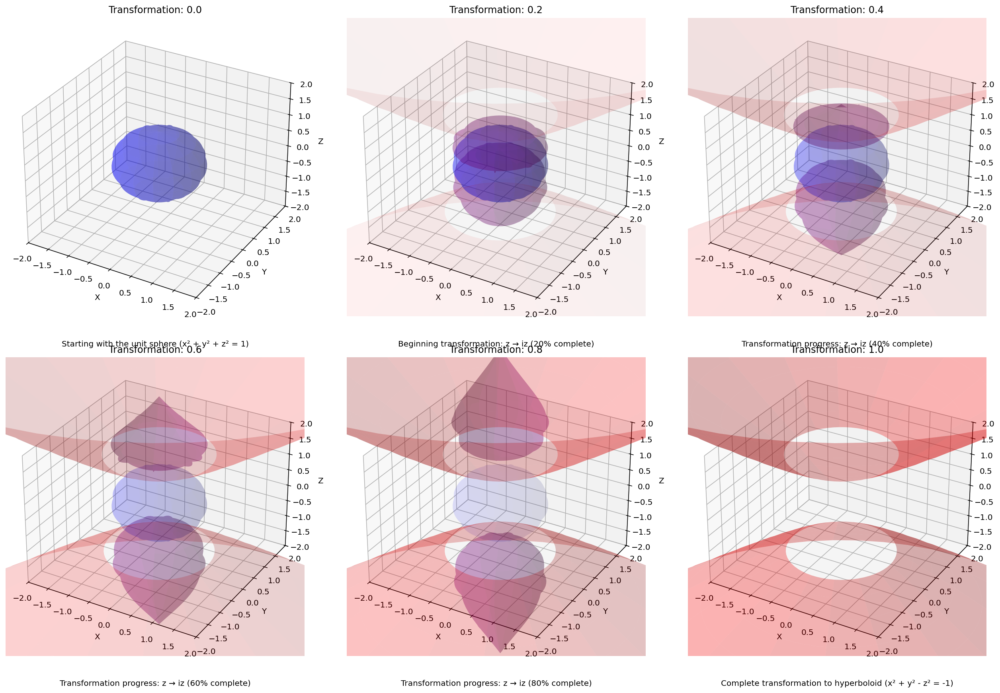

Creating comprehensive visualization...


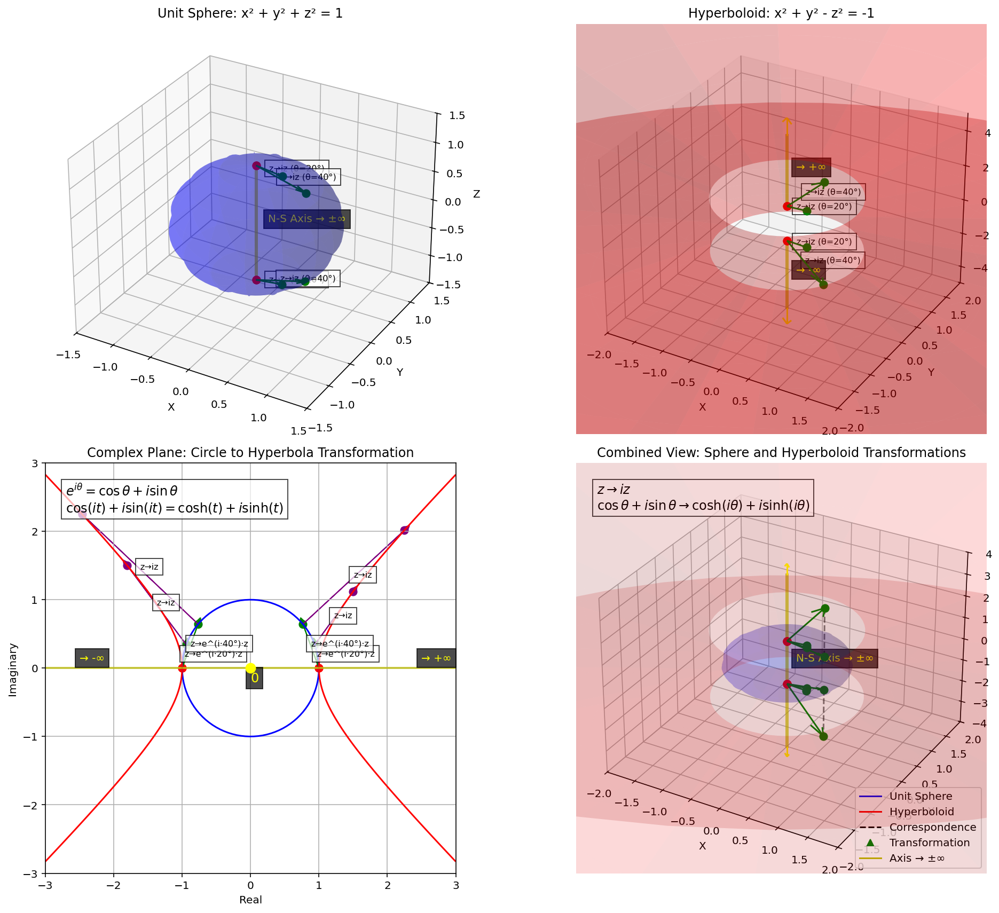

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation
from IPython.display import HTML, display

def create_html_animation():
    """
    Create an HTML animation of the sphere-hyperbolic transformation.
    """
    # Create figure
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Create unit sphere
    u = np.linspace(0, 2 * np.pi, 60)  # Reduced resolution for better performance
    v = np.linspace(0, np.pi, 30)
    x = np.outer(np.cos(u), np.sin(v))
    y = np.outer(np.sin(u), np.sin(v))
    z = np.outer(np.ones(np.size(u)), np.cos(v))

    # Create hyperboloid
    u_h = np.linspace(0, 2 * np.pi, 60)
    v_h = np.linspace(1, 2.5, 30) # Changed to 30 points to match v

    # Upper sheet
    x_h1 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h1 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h1 = np.outer(np.ones(np.size(u_h)), np.cosh(v_h))

    # Lower sheet
    x_h2 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h2 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h2 = np.outer(np.ones(np.size(u_h)), -np.cosh(v_h))

    # Function to update the plot for each animation frame
    def update_frame(frame):
        ax.clear()

        # Set up the axes again
        ax.set_title('Sphere-Hyperbolic Duality: Transformation via z → iz')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_xlim(-2.0, 2.0)
        ax.set_ylim(-2.0, 2.0)
        ax.set_zlim(-2.0, 2.0)

        # Interpolation factor (oscillate between 0 and 1)
        t = abs(np.sin(frame * np.pi / 30))

        # Interpolate between sphere and hyperboloid
        sphere_alpha = max(0, 0.3 - 0.3 * t)
        hyperboloid_alpha = min(0.3, 0.3 * t)

        # Plot surfaces with updated alphas
        if sphere_alpha > 0:
            ax.plot_surface(x, y, z, color='b', alpha=sphere_alpha, rstride=4, cstride=4)

        if hyperboloid_alpha > 0:
            ax.plot_surface(x_h1, y_h1, z_h1, color='r', alpha=hyperboloid_alpha, rstride=4, cstride=4)
            ax.plot_surface(x_h2, y_h2, z_h2, color='r', alpha=hyperboloid_alpha, rstride=4, cstride=4)

        # Also show intermediate transformation
        if 0 < t < 1:
            # Create intermediate surface
            z_interp1 = z * (1-t) + z_h1 * t
            z_interp2 = z * (1-t) + z_h2 * t

            ax.plot_surface(x, y, z_interp1, color='purple', alpha=0.2, rstride=8, cstride=8)
            ax.plot_surface(x, y, z_interp2, color='purple', alpha=0.2, rstride=8, cstride=8)

        # Add text showing current transformation value
        ax.text2D(0.05, 0.95, f"Transformation: {t:.2f}", transform=ax.transAxes)

    # Create animation
    ani = animation.FuncAnimation(fig, update_frame, frames=60, interval=100)

    # Convert to HTML5 video
    html_animation = HTML(ani.to_jshtml())

    # Close the figure to free memory
    plt.close(fig)

    return html_animation

# Alternative: Create a sequence of static plots with explanatory text
def create_static_sequence():
    """
    Create a sequence of static plots showing the transformation with explanatory text.
    """
    # Create a 2x3 grid of plots showing the transformation at different stages
    fig = plt.figure(figsize=(18, 12))

    # Transformation values
    t_values = [0.0, 0.2, 0.4, 0.6, 0.8, 1.0]

    # Create unit sphere
    u = np.linspace(0, 2 * np.pi, 60)
    v = np.linspace(0, np.pi, 30)
    x = np.outer(np.cos(u), np.sin(v))
    y = np.outer(np.sin(u), np.sin(v))
    z = np.outer(np.ones(np.size(u)), np.cos(v))

    # Create hyperboloid
    u_h = np.linspace(0, 2 * np.pi, 60)
    v_h = np.linspace(1, 2.5, 30) # Changed to 30 points to match v

    # Upper sheet
    x_h1 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h1 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h1 = np.outer(np.ones(np.size(u_h)), np.cosh(v_h))

    # Lower sheet
    x_h2 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h2 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h2 = np.outer(np.ones(np.size(u_h)), -np.cosh(v_h))

    # Explanatory text for each stage
    explanations = [
        "Starting with the unit sphere (x² + y² + z² = 1)",
        "Beginning transformation: z → iz (20% complete)",
        "Transformation progress: z → iz (40% complete)",
        "Transformation progress: z → iz (60% complete)",
        "Transformation progress: z → iz (80% complete)",
        "Complete transformation to hyperboloid (x² + y² - z² = -1)"
    ]

    # Create subplots for each transformation stage
    for i, t in enumerate(t_values):
        ax = fig.add_subplot(2, 3, i+1, projection='3d')

        # Interpolate between sphere and hyperboloid
        sphere_alpha = max(0, 0.3 - 0.3 * t)
        hyperboloid_alpha = min(0.3, 0.3 * t)

        # Plot surfaces with updated alphas
        if sphere_alpha > 0:
            ax.plot_surface(x, y, z, color='b', alpha=sphere_alpha, rstride=4, cstride=4)

        if hyperboloid_alpha > 0:
            ax.plot_surface(x_h1, y_h1, z_h1, color='r', alpha=hyperboloid_alpha, rstride=4, cstride=4)
            ax.plot_surface(x_h2, y_h2, z_h2, color='r', alpha=hyperboloid_alpha, rstride=4, cstride=4)

        # Also show intermediate transformation
        if 0 < t < 1:
            # Create intermediate surface
            z_interp1 = z * (1-t) + z_h1 * t
            z_interp2 = z * (1-t) + z_h2 * t

            ax.plot_surface(x, y, z_interp1, color='purple', alpha=0.2, rstride=8, cstride=8)
            ax.plot_surface(x, y, z_interp2, color='purple', alpha=0.2, rstride=8, cstride=8)

        ax.set_title(f'Transformation: {t:.1f}')
        ax.text2D(0.5, -0.1, explanations[i], transform=ax.transAxes, ha='center')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_xlim(-2.0, 2.0)
        ax.set_ylim(-2.0, 2.0)
        ax.set_zlim(-2.0, 2.0)

    plt.tight_layout()
    return fig

# Function to create a single comprehensive visualization

def comprehensive_visualization():
    """
    Create an enhanced comprehensive visualization of the sphere-hyperboloid duality,
    highlighting the axis-to-infinity transformation and using improved visual elements.
    """
    fig = plt.figure(figsize=(15, 12))

    # Create a 2x2 grid
    ax1 = fig.add_subplot(221, projection='3d')  # Unit Sphere
    ax2 = fig.add_subplot(222, projection='3d')  # Hyperboloid
    ax3 = fig.add_subplot(223)                   # Complex Plane
    ax4 = fig.add_subplot(224, projection='3d')  # Combined View

    # Create unit sphere
    u = np.linspace(0, 2 * np.pi, 60)
    v = np.linspace(0, np.pi, 30)
    x = np.outer(np.cos(u), np.sin(v))
    y = np.outer(np.sin(u), np.sin(v))
    z = np.outer(np.ones(np.size(u)), np.cos(v))

    # Create hyperboloid
    u_h = np.linspace(0, 2 * np.pi, 60)
    v_h = np.linspace(1, 3.0, 30)  # Extended range for better visualization

    # Upper sheet
    x_h1 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h1 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h1 = np.outer(np.ones(np.size(u_h)), np.cosh(v_h))

    # Lower sheet
    x_h2 = np.outer(np.cos(u_h), np.sinh(v_h))
    y_h2 = np.outer(np.sin(u_h), np.sinh(v_h))
    z_h2 = np.outer(np.ones(np.size(u_h)), -np.cosh(v_h))

    # 1. Unit Sphere with transformations from poles and axis visualization
    ax1.plot_surface(x, y, z, color='b', alpha=0.3, rstride=4, cstride=4)

    # Define transformation angles (adjusted for better visibility)
    angles = [np.pi/9, np.pi/4.5]  # 20 and 40 degrees

    # Define points on sphere and their transformations
    sphere_transformations = []

    # From North pole (0,0,1)
    for angle in angles:
        # Start point is North pole
        start = (0, 0, 1)

        # End point is rotated from North pole
        end_x = np.sin(angle)
        end_y = 0
        end_z = np.cos(angle)
        end = (end_x, end_y, end_z)

        # Add to transformations list
        sphere_transformations.append((start, end, f"z→iz (θ={angle*180/np.pi:.0f}°)"))

    # From South pole (0,0,-1)
    for angle in angles:
        # Start point is South pole
        start = (0, 0, -1)

        # End point is rotated from South pole
        end_x = np.sin(angle)
        end_y = 0
        end_z = -np.cos(angle)
        end = (end_x, end_y, end_z)

        # Add to transformations list
        sphere_transformations.append((start, end, f"z→iz (θ={angle*180/np.pi:.0f}°)"))

    # Plot transformations on sphere
    for start, end, label in sphere_transformations:
        # Plot start and end points
        ax1.scatter(*start, color='red', s=50)
        ax1.scatter(*end, color='green', s=50)

        # Draw arrow from start to end
        ax1.quiver(start[0], start[1], start[2],
                  end[0]-start[0], end[1]-start[1], end[2]-start[2],
                  color='green', arrow_length_ratio=0.2)

        # Add label
        midpoint = ((start[0] + end[0])/2, (start[1] + end[1])/2, (start[2] + end[2])/2)
        ax1.text(midpoint[0], midpoint[1], midpoint[2], label, fontsize=8,
                bbox=dict(facecolor='white', alpha=0.7))

    # Highlight the axis from North to South pole
    # Create points along the axis
    axis_points = np.linspace(-1, 1, 20)
    axis_x = np.zeros_like(axis_points)
    axis_y = np.zeros_like(axis_points)
    axis_z = axis_points

    # Plot the axis with a special color
    ax1.plot(axis_x, axis_y, axis_z, 'y-', linewidth=3, alpha=0.7)

    # Add label for the axis
    ax1.text(0.1, 0.1, 0, "N-S Axis → ±∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))

    ax1.set_title('Unit Sphere: x² + y² + z² = 1')
    ax1.set_xlabel('X')
    ax1.set_ylabel('Y')
    ax1.set_zlabel('Z')
    ax1.set_xlim(-1.5, 1.5)
    ax1.set_ylim(-1.5, 1.5)
    ax1.set_zlim(-1.5, 1.5)

    # 2. Hyperboloid with corresponding transformations and axis visualization
    ax2.plot_surface(x_h1, y_h1, z_h1, color='r', alpha=0.3, rstride=4, cstride=4)
    ax2.plot_surface(x_h2, y_h2, z_h2, color='r', alpha=0.3, rstride=4, cstride=4)

    # Define corresponding transformations on hyperboloid
    hyperboloid_transformations = []

    # For each sphere transformation, calculate the corresponding hyperboloid transformation
    for i, (start, end, label) in enumerate(sphere_transformations):
        # Start point on hyperboloid
        if start[2] > 0:  # North pole
            h_start = (0, 0, 1)  # Point on upper hyperboloid
        else:  # South pole
            h_start = (0, 0, -1)  # Point on lower hyperboloid

        # End point on hyperboloid
        h_end_x = end[0]
        h_end_y = end[1]

        # Calculate z coordinate on hyperboloid with scaling
        scale_factor = 1.0 + (i % 2) * 1.5  # 1.0 for first angle, 2.5 for second angle

        if np.abs(end[0]**2 + end[1]**2) < 1:
            h_end_z = np.sqrt(1 + end[0]**2 + end[1]**2) * scale_factor
            if end[2] < 0:  # If original point was on lower hemisphere
                h_end_z = -h_end_z
        else:
            h_end_x = end[0] * 0.9
            h_end_y = end[1] * 0.9
            h_end_z = np.sqrt(1 + h_end_x**2 + h_end_y**2) * scale_factor
            if end[2] < 0:
                h_end_z = -h_end_z

        h_end = (h_end_x, h_end_y, h_end_z)

        # Add to hyperboloid transformations
        hyperboloid_transformations.append((h_start, h_end, label))

    # Plot transformations on hyperboloid
    for start, end, label in hyperboloid_transformations:
        # Plot start and end points
        ax2.scatter(*start, color='red', s=50)
        ax2.scatter(*end, color='green', s=50)

        # Draw arrow from start to end
        ax2.quiver(start[0], start[1], start[2],
                  end[0]-start[0], end[1]-start[1], end[2]-start[2],
                  color='green', arrow_length_ratio=0.2)

        # Add label
        midpoint = ((start[0] + end[0])/2, (start[1] + end[1])/2, (start[2] + end[2])/2)
        ax2.text(midpoint[0], midpoint[1], midpoint[2], label, fontsize=8,
                bbox=dict(facecolor='white', alpha=0.7))

    # Visualize the axis extending to infinity
    # Create points along the z-axis
    z_axis_upper = np.linspace(1, 5, 100)  # Upper part
    z_axis_lower = np.linspace(-5, -1, 100)  # Lower part

    # Plot the axis with a special color and gradient
    ax2.plot(np.zeros_like(z_axis_upper), np.zeros_like(z_axis_upper), z_axis_upper,
             'y-', linewidth=3, alpha=0.7)
    ax2.plot(np.zeros_like(z_axis_lower), np.zeros_like(z_axis_lower), z_axis_lower,
             'y-', linewidth=3, alpha=0.7)

    # Add arrows indicating extension to infinity
    ax2.quiver(0, 0, 5, 0, 0, 1, color='yellow', length=1, arrow_length_ratio=0.3)
    ax2.quiver(0, 0, -5, 0, 0, -1, color='yellow', length=1, arrow_length_ratio=0.3)

    # Add label for the axis
    ax2.text(0.1, 0.1, 3, "→ +∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))
    ax2.text(0.1, 0.1, -3, "→ -∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))

    ax2.set_title('Hyperboloid: x² + y² - z² = -1')
    ax2.set_xlabel('X')
    ax2.set_ylabel('Y')
    ax2.set_zlabel('Z')
    ax2.set_xlim(-2.0, 2.0)
    ax2.set_ylim(-2.0, 2.0)
    ax2.set_zlim(-5.0, 5.0)  # Extended z range to show the axis to infinity

    # 3. Complex Plane with transformations and cross-section visualization
    # Draw unit circle
    theta = np.linspace(0, 2*np.pi, 100)
    x_circle = np.cos(theta)
    y_circle = np.sin(theta)
    ax3.plot(x_circle, y_circle, 'b-')

    # Draw hyperbola
    x_range = np.linspace(-3, 3, 1000)
    y_range = np.linspace(-3, 3, 1000)
    X, Y = np.meshgrid(x_range, y_range)
    Z = X**2 - Y**2 - 1
    ax3.contour(X, Y, Z, levels=[0], colors='r')

    # Define transformations on complex plane
    complex_transformations = []

    # From point 1 on real axis
    for i, angle in enumerate(angles):
        # Start point is 1
        start = (1, 0)

        # End point is rotated by angle
        end_x = np.cos(angle)
        end_y = np.sin(angle)
        end = (end_x, end_y)

        # Add to transformations
        complex_transformations.append((start, end, f"z→e^(i·{angle*180/np.pi:.0f}°)·z"))

    # From point -1 on real axis
    for i, angle in enumerate(angles):
        # Start point is -1
        start = (-1, 0)

        # End point is rotated by angle
        end_x = -np.cos(angle)
        end_y = np.sin(angle)
        end = (end_x, end_y)

        # Add to transformations
        complex_transformations.append((start, end, f"z→e^(i·{angle*180/np.pi:.0f}°)·z"))

    # Plot transformations on complex plane
    for start, end, label in complex_transformations:
        # Plot start and end points
        ax3.scatter(start[0], start[1], color='red', s=50)
        ax3.scatter(end[0], end[1], color='green', s=50)

        # Draw arrow from start to end with gradient color
        ax3.arrow(start[0], start[1],
                 end[0]-start[0], end[1]-start[1],
                 head_width=0.1, head_length=0.1, fc='green', ec='green')

        # Add label
        midpoint = ((start[0] + end[0])/2, (start[1] + end[1])/2)
        ax3.text(midpoint[0], midpoint[1], label, fontsize=8,
                bbox=dict(facecolor='white', alpha=0.7))

    # Add arrows from points on circle to hyperbola
    for i, (_, end, _) in enumerate(complex_transformations):
        # Find corresponding point on hyperbola
        angle = np.arctan2(end[1], end[0])

        # Calculate point on hyperbola with different distances for different angles
        scale_factor = 1.0 + (i % 2) * 0.5  # 1.0 for first angle, 1.5 for second angle

        if abs(angle) < np.pi/4:  # Use x-parametrization for angles near 0
            h_x = 1.5 * scale_factor
            h_y = np.sqrt(h_x**2 - 1)
            if angle < 0:
                h_y = -h_y
        else:  # Use y-parametrization for angles near π/2
            h_y = 1.5 * scale_factor
            h_x = np.sqrt(1 + h_y**2)
            if abs(angle) > np.pi/2:
                h_x = -h_x

        h_point = (h_x, h_y)

        # Draw arrow from circle to hyperbola
        ax3.arrow(end[0], end[1],
                 h_point[0]-end[0], h_point[1]-end[1],
                 head_width=0.1, head_length=0.1, fc='purple', ec='purple')

        # Add label
        midpoint = ((end[0] + h_point[0])/2, (end[1] + h_point[1])/2)
        ax3.text(midpoint[0], midpoint[1], "z→iz", fontsize=8,
                bbox=dict(facecolor='white', alpha=0.7))

        # Plot point on hyperbola
        ax3.scatter(h_point[0], h_point[1], color='purple', s=50)

    # Visualize the real axis mapping to infinity
    # Draw the real axis
    ax3.plot([-3, 3], [0, 0], 'y-', linewidth=2, alpha=0.7)

    # Add special points
    ax3.scatter([0], [0], color='yellow', s=80, zorder=10)  # Origin

    # Add labels
    ax3.text(0, -0.2, "0", color='yellow', fontsize=12,
            bbox=dict(facecolor='black', alpha=0.7))
    ax3.text(2.5, 0.1, "→ +∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))
    ax3.text(-2.5, 0.1, "→ -∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))

    # Add formula box
    formula_text = r"$e^{i\theta} = \cos\theta + i\sin\theta$" + "\n" + r"$\cos(it) + i\sin(it) = \cosh(t) + i\sinh(t)$"
    ax3.text(0.05, 0.95, formula_text, transform=ax3.transAxes, fontsize=12,
             verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    ax3.set_title('Complex Plane: Circle to Hyperbola Transformation')
    ax3.set_xlabel('Real')
    ax3.set_ylabel('Imaginary')
    ax3.grid(True)
    ax3.set_aspect('equal')
    ax3.set_xlim(-3.0, 3.0)
    ax3.set_ylim(-3.0, 3.0)

    # 4. Combined View with all transformations and axis visualization
    # Show both sphere and hyperboloid with transparency
    ax4.plot_surface(x, y, z, color='b', alpha=0.15, rstride=4, cstride=4)
    ax4.plot_surface(x_h1, y_h1, z_h1, color='r', alpha=0.15, rstride=4, cstride=4)
    ax4.plot_surface(x_h2, y_h2, z_h2, color='r', alpha=0.15, rstride=4, cstride=4)

    # Plot all sphere transformations
    for start, end, label in sphere_transformations:
        # Plot start and end points
        ax4.scatter(*start, color='red', s=50)
        ax4.scatter(*end, color='green', s=50)

        # Draw arrow from start to end
        ax4.quiver(start[0], start[1], start[2],
                  end[0]-start[0], end[1]-start[1], end[2]-start[2],
                  color='green', arrow_length_ratio=0.2)

    # Plot all hyperboloid transformations
    for start, end, label in hyperboloid_transformations:
        # Plot start and end points
        ax4.scatter(*start, color='red', s=50)
        ax4.scatter(*end, color='green', s=50)

        # Draw arrow from start to end
        ax4.quiver(start[0], start[1], start[2],
                  end[0]-start[0], end[1]-start[1], end[2]-start[2],
                  color='green', arrow_length_ratio=0.2)

    # Connect corresponding points between sphere and hyperboloid
    for i in range(len(sphere_transformations)):
        # Connect start points
        s_start = sphere_transformations[i][0]
        h_start = hyperboloid_transformations[i][0]
        ax4.plot([s_start[0], h_start[0]],
                [s_start[1], h_start[1]],
                [s_start[2], h_start[2]],
                'k--', alpha=0.5)

        # Connect end points
        s_end = sphere_transformations[i][1]
        h_end = hyperboloid_transformations[i][1]
        ax4.plot([s_end[0], h_end[0]],
                [s_end[1], h_end[1]],
                [s_end[2], h_end[2]],
                'k--', alpha=0.5)

    # Visualize the axis transformation
    # Sphere axis
    ax4.plot([0, 0], [0, 0], [-1, 1], 'y-', linewidth=3, alpha=0.7)

    # Hyperboloid axis
    z_axis_upper = np.linspace(1, 4, 50)
    z_axis_lower = np.linspace(-4, -1, 50)
    ax4.plot(np.zeros_like(z_axis_upper), np.zeros_like(z_axis_upper), z_axis_upper,
             'y-', linewidth=3, alpha=0.7)
    ax4.plot(np.zeros_like(z_axis_lower), np.zeros_like(z_axis_lower), z_axis_lower,
             'y-', linewidth=3, alpha=0.7)

    # Add arrows indicating extension to infinity
    ax4.quiver(0, 0, 4, 0, 0, 1, color='yellow', length=0.5, arrow_length_ratio=0.3)
    ax4.quiver(0, 0, -4, 0, 0, -1, color='yellow', length=0.5, arrow_length_ratio=0.3)

    # Add label for the axis transformation
    ax4.text(0.1, 0.1, 0, "N-S Axis → ±∞", color='yellow', fontsize=10,
            bbox=dict(facecolor='black', alpha=0.7))

    ax4.set_title('Combined View: Sphere and Hyperboloid Transformations')
    ax4.set_xlabel('X')
    ax4.set_ylabel('Y')
    ax4.set_zlabel('Z')
    ax4.set_xlim(-2.0, 2.0)
    ax4.set_ylim(-2.0, 2.0)
    ax4.set_zlim(-4.0, 4.0)

    # Add legend
    ax4.plot([], [], 'b-', label='Unit Sphere')
    ax4.plot([], [], 'r-', label='Hyperboloid')
    ax4.plot([], [], 'k--', label='Correspondence')
    ax4.plot([], [], '^', color='green', label='Transformation')
    ax4.plot([], [], 'y-', label='Axis → ±∞')
    ax4.legend()

    # Add formula explanation
    formula_text = r"$z \rightarrow iz$" + "\n" + r"$\cos\theta + i\sin\theta \rightarrow \cosh(i\theta) + i\sinh(i\theta)$"
    ax4.text2D(0.05, 0.95, formula_text, transform=ax4.transAxes, fontsize=12,
             verticalalignment='top', bbox=dict(facecolor='white', alpha=0.7))

    plt.tight_layout()
    return fig



# Run the visualizations in a Jupyter notebook
def run_visualizations():
    # Try to create HTML animation
    try:
        print("Creating HTML animation...")
        html_anim = create_html_animation()
        display(html_anim)
    except Exception as e:
        print(f"HTML animation failed: {e}")
        print("Falling back to static visualizations...")

    # Create static sequence
    print("Creating static sequence visualization...")
    fig_sequence = create_static_sequence()
    plt.show()

    # Create comprehensive visualization
    print("Creating comprehensive visualization...")
    fig_comprehensive = comprehensive_visualization()
    plt.show()

# If running in a Jupyter notebook
if __name__ == "__main__":
    # Set up matplotlib for Jupyter
    try:
        from IPython.display import set_matplotlib_formats
        set_matplotlib_formats('retina')
    except ImportError:
        pass

    run_visualizations()

#### Hopfield Networks

Further analogy could be made with the Hopfield Networks (1982) that has been useful for research in biological neural networks and machine learning. The original concept was relatively simple and assumed a fully connected network (each neuron connects with all others), with binary outcomes and weights and uses random prototype patterns that are stored in the network. Importantly, unlike the von Neumann model of separating the cpu from memory, this model is more like a biological neural net with both processing and storage occurring on the same network. In such a network, current stat is compared to a prototype pattern, by measuring overlap of binary values between the state (si) and prototype (pi𝜇).

Derivation of overlap equation:
$S_{i}(t+1) = sgn[Σ_{j} w_{ij} S_{j}(t)]$
  
$= sgn[Σ_{j} Σ_{𝜇} p_{i𝜇} p_{j𝜇} S_{j}(t)]$
  
$= sgn[NΣ_{𝜇} p_{j𝜇}m_{𝜇}(t)]$

$m_{𝜇}(t+1) = 1/N Σ_{j}p_{j𝜇}S_{j}(t+1)$

Thus, there is a recursive relationship between the rule for overlap of patterns and states and the next state.


<img src="images/Hopfield.png" style="display:block; margin:auto" width="500"/>

The **weights** in Hopfield network are **Hebbian** (i.e. increases with joint firing of neurons). Real neurons are not fully connected nor have symmetrical weights. Later developments in this fields permit derivation of isomorphism between **Hopfield networks** and the **Boltzmann machines** that use the **partition function**. Importantly more recent developments permit restricted **Boltzmann machines** that are **graph like** (with hidden layers) and are **not fully connected**. Moreover, by introducing **stochasticity** to Hopfield models, it is possible to generate **non-linear activation functions** like **tanh** to produce models that are more aligned with biological networks.

Here we have utilized **continuous** functions in formal mathematics that lead to corresponding **discrete outcomes** necessary in both quantum mechanics and machine learning. This connection between continuous and discrete will be further discussed later as developed by **Eva Miranda's group** connecting steady state solutions to the **Navier Stokes equations** intersect with **Cantor set** (a discrete infinite set in chaos theory). Hopfield model has provided significant connection between artificial and biological networks, especially as Hopfield network can be demonstrated to be equivalent to Botzmann machines on which many modern machine learning algorithms (e.g. Deep Neural Networks and Recurrent Neural Networks) are based.

The model proposed by us is to combining **D-M distribution** and **XOR-XNOR signed recursion** that has following advantages:
  
**Stochasticity** is built in with D-M distribution
  
It does **not** require a **fully connected network**.
  
It has a **graph-like structure** suitable for layers that occur in **Deep Neural Networks**, **without** the need for **hidden layers** (the layers are related transparently, via the **deterministic logic** and **stochastic probability** distribution).
  
It is analogous to restricted **Boltzmann machines.**
  
Due to its **binarized nature**, the recursion using XOR and XNOR can be hypothesized to be a **faster algorithm** requiring less computer resources
  
As a further extension, combined use of a probability distribution such as Dirichlet (Alpha) Multinomial and XOR-XNOR recursion as outlined here, it is possible to model processes like **Markov Chain Monte Carlo (MCMC)**, that leads to modelling dynamic evolution of a system as a graph.


### F) MCMC, XOR-XOR recursion relation

In the sphere rotation experiment bove, it can be seen the rotation of the sphere appears not regular (possibly random) and could be considered to sample the complex plane on the surface of the sphere. Further, the rotation alternates between orthogonal axes, thus resulting in changes in orthogonl palnes that are antipodal in nature, related by Möbius transformation. This coupling of possible random sampling can be explicitly created by adding a stochastic component (either random input or Dirichlet Multinomial or both), that drives the sphere rotation. We asert that this is akin to an MCMC like process.

In the next chapter, a series of experiments with prompts to Google Colab AI Gemini are summarised. These experiments provided high confidence that what we observe is a MCMC like process, thus giving confidence for the proposed algorithm comprising XOR-XNOR recursion modulated by Dirichlet (Alpha) Multinomial Distribution has capacity to create machine learning graphs.

In the following chapter (chapter 7) we present the experiment of sphere rotation that produces plausible membrane dynamics. Given that membrane dynamics were not used to generate our proposed model, it was considered an appropiate simulation test of the plausibility of the model.

Subsequnet chapters introduce the culmination of a set of experiments that converged at th ecreation of our canonical algoriths, **Life Emulating Orchestrated Network** or **LEON**